## Machine Learning for Breast Cancer Detection - Primary Option B

**Objective**

The objective of this project is to develop a machine learning model to accurately diagnose breast cancer (benign or malignant) based on the characteristics of cell nuclei in breast cancer biopsies. The model will be trained on the Breast Cancer Wisconsin (Diagnostic) dataset, which contains various features of cell nuclei such as radius, texture, smoothness, and compactness.

**Topics covered in this notebook**


1. Understanding the problem statement
2. Data collection
3. Importing data libraries
4. Exploratory Data Analysis
5. Data Pre-processing
6. Training the model
7. Best model 


**Problem Statement**

Given the set of features for each tumor (e.g., radius, smoothness, compactness), the goal is to predict whether the tumor is malignant or benign. The challenge lies in designing and training a machine learning model that can accurately classify these tumors, ensuring the model minimizes both false positives (predicting benign when malignant) and false negatives (predicting malignant when benign).

**Import necessary libraries**

In [1]:
import pandas as pd
import numpy as np
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix, recall_score, precision_score, classification_report
from sklearn.model_selection import train_test_split,KFold, GridSearchCV, RandomizedSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.neighbors import KNeighborsClassifier
from sklearn import model_selection
from sklearn.svm import SVC


from sklearn.ensemble import RandomForestClassifier
import seaborn as sns
import matplotlib.pyplot as plt
from pandas.plotting import scatter_matrix
from sklearn.preprocessing import StandardScaler
from ucimlrepo import fetch_ucirepo 

In [2]:
pip install ucimlrepo

Note: you may need to restart the kernel to use updated packages.


Import the dataset from https://archive.ics.uci.edu/ml/datasets/Breast+Cancer+Wisconsin+(Diagnostic)

In [3]:
breast_cancer_wisconsin_diagnostic = fetch_ucirepo(id=17) 
  
X = breast_cancer_wisconsin_diagnostic.data.features 
y = breast_cancer_wisconsin_diagnostic.data.targets 

In [4]:
df = pd.concat([X, y], axis=1)
df.to_csv('breast_cancer_wisconsin_B.csv', index=False)

data1 = pd.read_csv("breast_cancer_wisconsin_B.csv")
data1

,radius1,texture1,perimeter1,area1,smoothness1,compactness1,concavity1,concave_points1,symmetry1,fractal_dimension1,...,texture3,perimeter3,area3,smoothness3,compactness3,concavity3,concave_points3,symmetry3,fractal_dimension3,Diagnosis
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,0.2419,0.07871,...,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890,M
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,0.1812,0.05667,...,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902,M
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,0.2069,0.05999,...,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758,M
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,0.09744,...,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300,M
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,0.1809,0.05883,...,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678,M
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,0.05623,...,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115,M
565,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,0.05533,...,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637,M
566,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,0.05648,...,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820,M
567,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,0.07016,...,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400,M


**Exploratory data analysis and pre-processing of the data**

In [5]:
data1['Diagnosis'] = data1['Diagnosis'].map({'M': 1, 'B': 0})

In [6]:
data1.isna().sum()

radius1               0
texture1              0
perimeter1            0
area1                 0
smoothness1           0
compactness1          0
concavity1            0
concave_points1       0
symmetry1             0
fractal_dimension1    0
radius2               0
texture2              0
perimeter2            0
area2                 0
smoothness2           0
compactness2          0
concavity2            0
concave_points2       0
symmetry2             0
fractal_dimension2    0
radius3               0
texture3              0
perimeter3            0
area3                 0
smoothness3           0
compactness3          0
concavity3            0
concave_points3       0
symmetry3             0
fractal_dimension3    0
Diagnosis             0
dtype: int64

In [7]:
data1.describe()

,radius1,texture1,perimeter1,area1,smoothness1,compactness1,concavity1,concave_points1,symmetry1,fractal_dimension1,...,texture3,perimeter3,area3,smoothness3,compactness3,concavity3,concave_points3,symmetry3,fractal_dimension3,Diagnosis
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,0.062798,...,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946,0.372583
std,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,0.007060,...,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061,0.483918
min,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,0.049960,...,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040,0.000000
25%,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,0.057700,...,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460,0.000000
50%,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,0.061540,...,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040,0.000000
75%,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,0.066120,...,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080,1.000000
max,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,0.097440,...,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500,1.000000


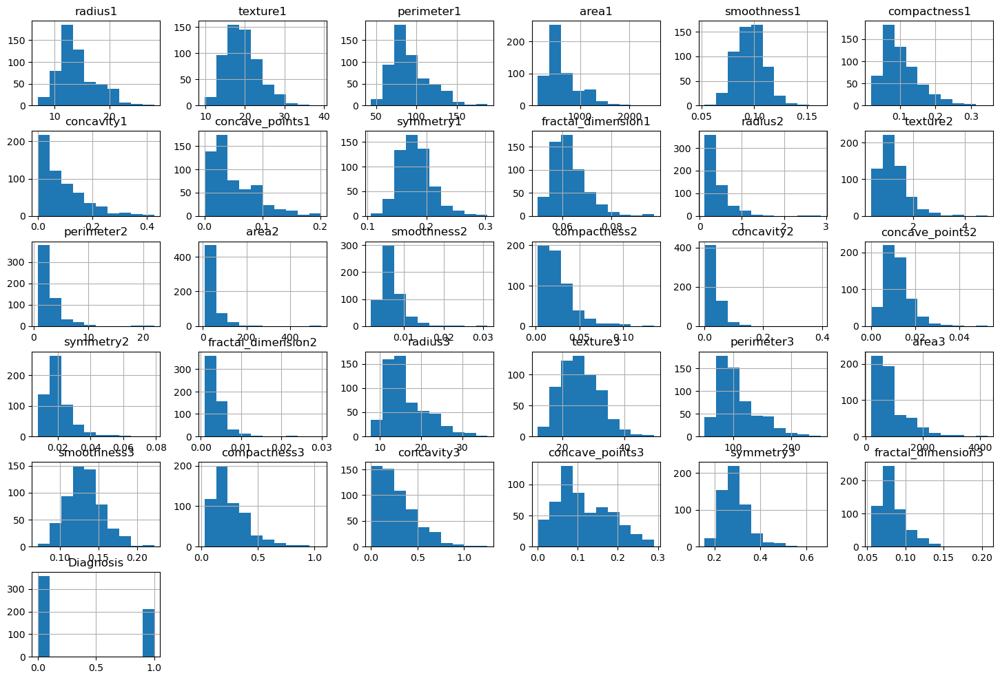

In [8]:
data1.hist(figsize=(18,12))
plt.show()

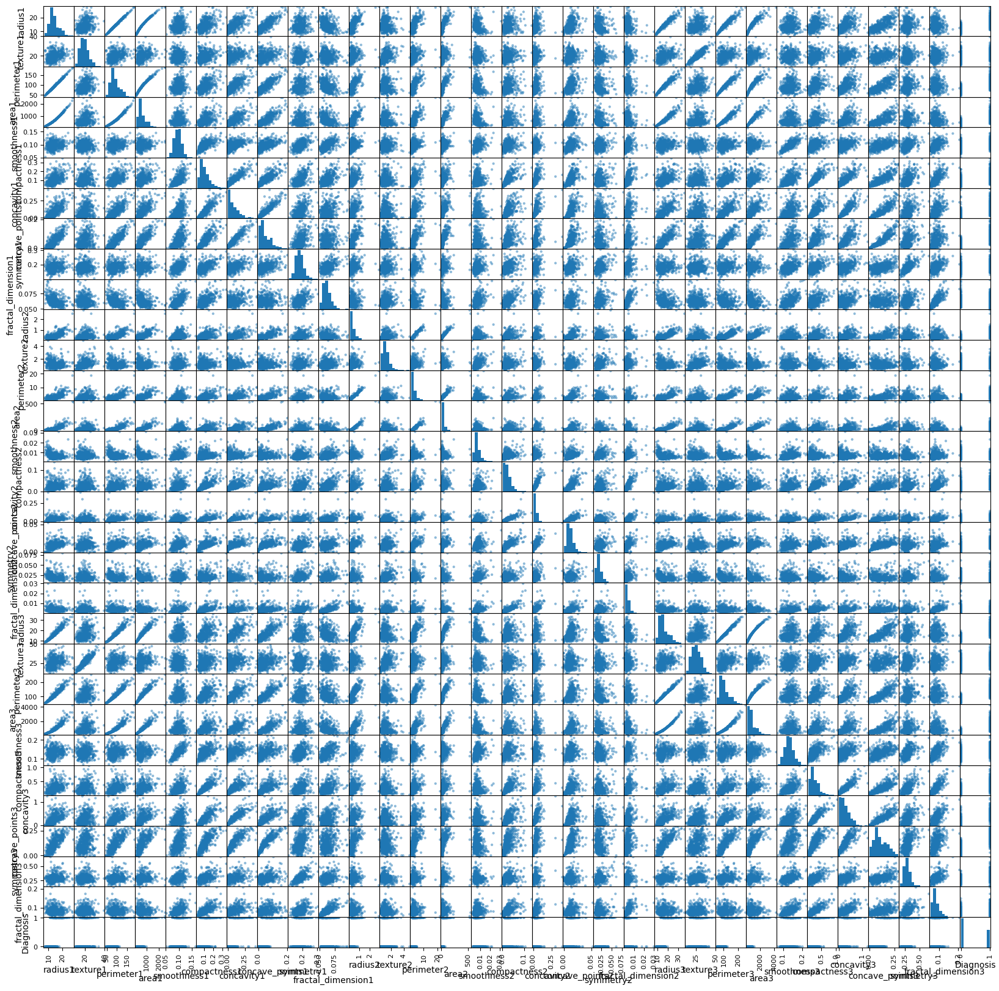

In [9]:
scatter_matrix(data1, figsize=(20,20))
plt.show()

In [10]:
sns.pairplot(data1, hue='Diagnosis', palette='coolwarm', diag_kind='kde')
plt.show()

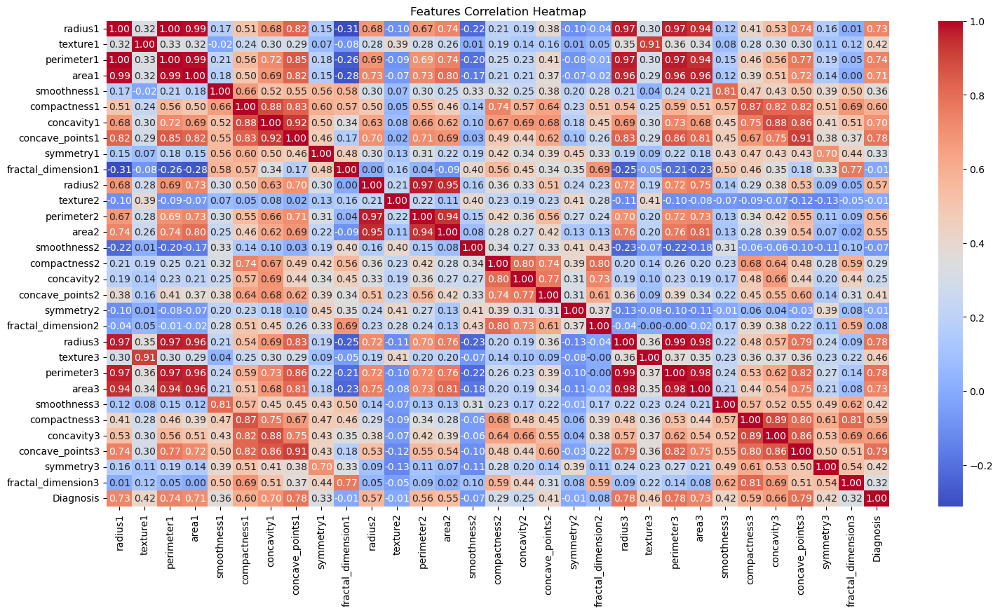

In [11]:
correlation_matrix = data1.corr()
plt.figure(figsize=(18, 9))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm')
plt.title("Features Correlation Heatmap")
plt.show()

**Splitting of the data into training and test** <br>
**feature scaling or standardization**

In [12]:
X = data1.drop('Diagnosis', axis=1)
y = data1['Diagnosis']

X_train, X_test , y_train, y_test = train_test_split(X, y, test_size=0.2, random_state = 10, stratify=y)

In [14]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

Let's use 5-fold cross-validation and GridSearchCV/RandomizedSearchCV for hyperparameter tuning.

**1. KNN**

In [15]:
Knn = KNeighborsClassifier()
param_grid_knn = {
    'n_neighbors': range(1, 20),
    'weights': ['uniform', 'distance'],
    'metric': ['euclidean', 'manhattan', 'minkowski']
}
grid_knn  = GridSearchCV(Knn, param_grid_knn, cv = 5, scoring='accuracy')
grid_knn.fit(X_train_scaled, y_train)

print("Best Parameters for KNN:", grid_knn.best_params_)

Best Parameters for KNN: {'metric': 'euclidean', 'n_neighbors': 7, 'weights': 'uniform'}


In [16]:
knn_best = grid_knn.best_estimator_
y_pred_knn = knn_best.predict(X_test_scaled)
print("KNN Accuracy:", accuracy_score(y_test, y_pred_knn))
print(classification_report(y_test, y_pred_knn))
print(confusion_matrix(y_test,y_pred_knn))

KNN Accuracy: 0.9736842105263158
              precision    recall  f1-score   support

           0       0.96      1.00      0.98        72
           1       1.00      0.93      0.96        42

    accuracy                           0.97       114
   macro avg       0.98      0.96      0.97       114
weighted avg       0.97      0.97      0.97       114

[[72  0]
 [ 3 39]]


**3. Random Forest**

In [17]:
rf = RandomForestClassifier(random_state=10)
param_grid_rf = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

randomized_rf = RandomizedSearchCV(rf, param_grid_rf, cv=5, scoring='accuracy', n_iter=20, random_state=10)
randomized_rf.fit(X_train_scaled, y_train)

print("Best Parameters for Random Forest:", randomized_rf.best_params_)

Best Parameters for Random Forest: {'n_estimators': 200, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': 20}


In [18]:
rf_best = randomized_rf.best_estimator_
y_pred_rf = rf_best.predict(X_test_scaled)
print("Random Forest Accuracy:", accuracy_score(y_test, y_pred_rf))
print(classification_report(y_test, y_pred_rf))
print(confusion_matrix(y_test,y_pred_rf))

Random Forest Accuracy: 0.9736842105263158
              precision    recall  f1-score   support

           0       0.99      0.97      0.98        72
           1       0.95      0.98      0.96        42

    accuracy                           0.97       114
   macro avg       0.97      0.97      0.97       114
weighted avg       0.97      0.97      0.97       114

[[70  2]
 [ 1 41]]


**2. SVM**

In [19]:
svm = SVC(probability=True)
param_grid_svm = {
    'C': [0.1, 1, 10, 100],
    'kernel': ['linear', 'poly'],
    'gamma': ['scale', 'auto']
}

grid_svm = GridSearchCV(svm, param_grid_svm, cv=5, scoring='accuracy')
grid_svm.fit(X_train_scaled, y_train)

print("Best Parameters for SVM:", grid_svm.best_params_)

Best Parameters for SVM: {'C': 0.1, 'gamma': 'scale', 'kernel': 'linear'}


In [20]:
svm_best = grid_svm.best_estimator_
y_pred_svm = svm_best.predict(X_test_scaled)
print("SVM Accuracy:", accuracy_score(y_test, y_pred_svm))
print(classification_report(y_test, y_pred_svm))
print(confusion_matrix(y_test,y_pred_svm))

SVM Accuracy: 0.9649122807017544
              precision    recall  f1-score   support

           0       0.96      0.99      0.97        72
           1       0.97      0.93      0.95        42

    accuracy                           0.96       114
   macro avg       0.97      0.96      0.96       114
weighted avg       0.97      0.96      0.96       114

[[71  1]
 [ 3 39]]


**Results**

In [25]:
def get_metrics(y_test, y_pred):
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    tn, fp, fn, tp = confusion_matrix(y_test, y_pred).ravel()
    specificity = tn / (tn + fp)
    return accuracy, precision, recall, f1, specificity

knn_metrics = get_metrics(y_test, y_pred_knn)
svm_metrics = get_metrics(y_test, y_pred_svm)
rf_metrics = get_metrics(y_test, y_pred_rf)

summary_df = pd.DataFrame({
    'Model': ['KNN', 'SVM', 'Random Forest'],
    'Accuracy': [knn_metrics[0], svm_metrics[0], rf_metrics[0]],
    'Precision': [knn_metrics[1], svm_metrics[1], rf_metrics[1]],
    'Recall(Sensitivity)': [knn_metrics[2], svm_metrics[2], rf_metrics[2]],
    'F1-Score': [knn_metrics[3], svm_metrics[3], rf_metrics[3]],
    'Specificity': [knn_metrics[4], svm_metrics[4], rf_metrics[4]]
})

summary_df

,Model,Accuracy,Precision,Recall(Sensitivity),F1-Score,Specificity
0,KNN,0.973684,1.000000,0.928571,0.962963,1.000000
1,SVM,0.964912,0.975000,0.928571,0.951220,0.986111
2,Random Forest,0.973684,0.953488,0.976190,0.964706,0.972222


**d) Write a brief (1-2 sentences) summary of each measure (2 points) and comment about each measure's score in your assessment of the two** 

**Answer:**

**Accuracy  :** Represents the proportion of correctly predicted outcomes out of all predictions made.
All models have high accuracy, indicating overall good performance in predicting correctly, with KNN and Random Forest achieving the highest (97.37%).<br>            
**Precision :** Measures how many of the positive predictions are actually correct (focuses on reducing false positives).
KNN achieves perfect precision (1.0), meaning it made no false-positive predictions, while Random Forest and SVM are slightly lower but still strong.<br>

**Recall    :** Represents the proportion of actual positives correctly identified (focuses on reducing false negatives).
Random Forest has the highest recall (0.976), indicating it missed fewer actual positive cases compared to the other models.<br>    
**F1-score  :** Harmonic mean of precision and recall, balancing both metrics for a more comprehensive performance measure.
All models have excellent F1-scores, with Random Forest leading slightly, suggesting its overall balance between precision and recall.<br>